In [1]:
%matplotlib ipympl
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from mpl_toolkits.mplot3d import Axes3D
import glob  # 用來搜尋多個檔案
import re  # 用正則表達式更穩定地抓數字

In [2]:
# 讀取檔案（自動處理逗號與空白）
df = pd.read_csv("transmission_data(x-0600nm).txt")

# 檢查讀入的資料
# print(df.head())

# 提取欄位
x = df["lambda(nm)"]
y = df[" Y"]

# 繪圖
plt.figure(figsize=(6, 4))
plt.plot(x, y, marker='.', markersize=1, linestyle='-', color='r')

# 標籤與標題
plt.ylim(0.25, 0.4)
plt.xlim(400, 700)
# plt.xlabel("Wavelength (nm)")
# plt.ylabel("Y value")
# plt.title("Plot of Y vs Wavelength")
plt.grid(True)

plt.show()


FileNotFoundError: [Errno 2] No such file or directory: 'transmission_data(x-0600nm).txt'

In [4]:
# 讀取 txt 檔案，略過第一列標題
data = np.loadtxt("xy.txt", skiprows=1)

# 取出兩欄資料
x = data[:, 0]*np.power(10, 6)   # 第一欄 → x 軸
y = data[:, 1]*np.power(10, 6)   # 第二欄 → y 軸

# 繪圖
plt.figure(figsize=(6, 4))
plt.plot(x, y, "ko", markersize=7)

plt.ylim(-1.75, 1.75)
plt.ylabel('um')
plt.xlim(-1.5, 1.5)
plt.xlabel('um')
# plt.title('Plot from TXT file with Header')
plt.legend()
plt.grid(True)

plt.show()

FileNotFoundError: xy.txt not found.

ValueError: could not convert string 'lambda(nm),' to float64 at row 0, column 1.

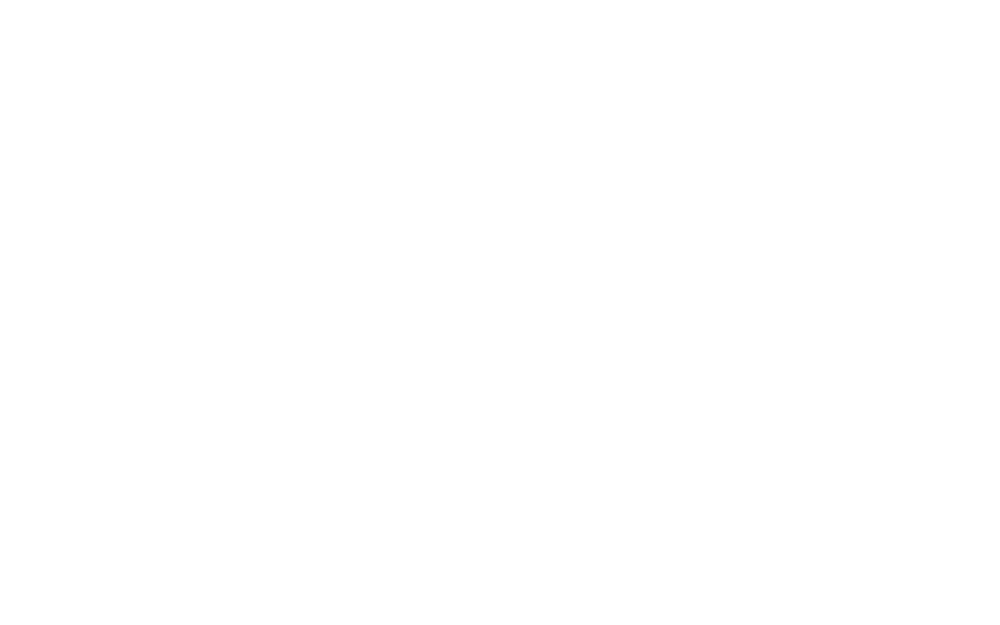

In [2]:
# 找所有 txt 檔案
files = glob.glob("*.txt")

Color = ['orange','r','b','pink','black','purple','brown','gray','cyan','g']
Marker = ['.', '.', '.', '.', '.', '.', '.', '.', '.', '.']

plt.figure(figsize=(8, 5), dpi=200)
i=0
for f in files:
    data = np.loadtxt(f)  # 讀取每個 txt
    x = data[:, 0]*np.power(10, 6)        # 第一欄 = X
    y = data[:, 1]*np.power(10, 6)        # |第二欄 = Y
    label_name = os.path.splitext(f)[0]   # ✅ 去除副檔名 .txt
    plt.plot(x, y, linewidth=0, marker=Marker[i], markersize=8, color=Color[i], label=label_name)  # 畫線
    i+=1

plt.xlabel("x (um)")
plt.ylabel("y (um)")
plt.ylim(-0.75, 0.75)
plt.xlim(-1.5, 1.5)
# plt.title("All curves from txt files")
plt.legend(fontsize=7, bbox_to_anchor=(1.2, 0.82), loc='center right')
plt.grid(True)
plt.tight_layout()
plt.show()

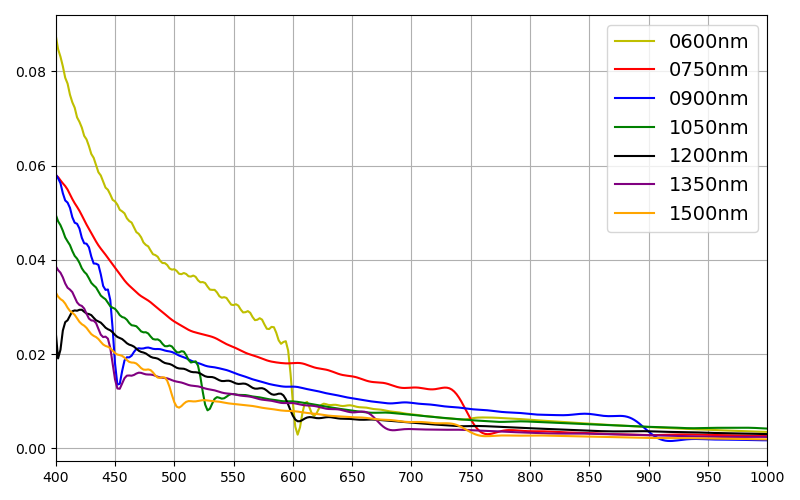

In [13]:
# 搜尋所有符合條件的 txt 檔
files = glob.glob("*.txt")  # 或指定路徑，例如 "data/*.txt"

plt.figure(figsize=(8, 5))

Linestyle = ['solid','solid','solid','solid','solid','solid','solid']
Color = ['y','r','b','g','k','purple','orange','cyan']
Linewidth = [1.5, 1.5, 1.5, 1.5, 1.5, 1.5, 1.5, 1.5, 1.5]

i=0
# 逐一讀取每個檔案並繪圖
for file in files:
    df = pd.read_csv(file)
    x = df["lambda(nm)"]
    y = df[" Y"]
    plt.plot(x, np.abs(y), label=file.replace(".txt", ""), linewidth=Linewidth[i], linestyle=Linestyle[i], color=Color[i])  # 檔名當作圖例名稱
    i+=1

# 加上圖例與標籤
# plt.xlabel("$𝜆$ (nm)")
# plt.ylabel("$|T|$")
# plt.title("Comparison of Multiple Datasets")
plt.legend(fontsize=14)
# plt.ylim(0, 0.082)
# plt.yticks(np.arange(0, 0.082, 0.01))
plt.xlim(400, 1000)
plt.xticks(np.arange(400, 1001, 50))
plt.grid(True)
plt.tight_layout()
plt.show()

IndexError: list index out of range

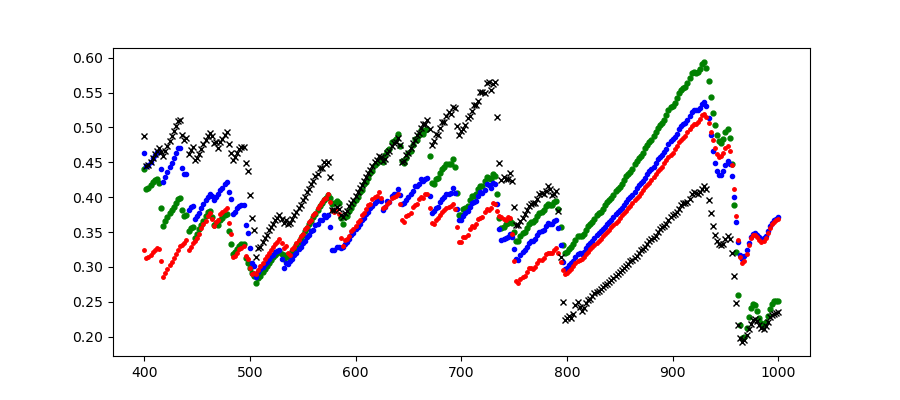

In [3]:
#收斂測試

# 搜尋所有符合條件的 txt 檔
files = glob.glob("*.txt")  # 或指定路徑，例如 "data/*.txt"

plt.figure(figsize=(9, 4))

Linewidth = [0.5, 1, 1.5, 3]
Zorder = [4, 3, 2, 1]
Linestyle = ['solid','dashed','dashed','dashed','solid','solid','solid','solid']
Color = ['black','r','b','g','k','purple','orange','cyan']
#, linewidth=Linewidth[i], linestyle=Linestyle[i]
Marker = ['x', '.', '.', '.']
Markersize = [4, 5, 6, 7]
i=0
# 逐一讀取每個檔案並繪圖
for file in files:
    df = pd.read_csv(file)
    x = df["lambda(nm)"]
    y = df[" Y"]
    plt.plot(x, y, label=file.replace(".txt", ""), linewidth=0, marker=Marker[i], markersize=Markersize[i], color=Color[i], zorder=Zorder[i])  # 檔名當作圖例名稱
    i+=1

# 加上圖例與標籤
# plt.xlabel("$𝜆$ (nm)")
# plt.ylabel("$|T|$")
# plt.title("Comparison of Multiple Datasets")
# plt.legend(fontsize=14, bbox_to_anchor=(1.2, 0.82), loc='center right')
plt.legend(fontsize=13)
plt.ylim(0.28, 0.88)
plt.yticks(np.arange(0.28, 0.881, 0.1))
plt.xlim(400, 1000)
plt.xticks(np.arange(400, 1001, 50))
plt.grid(True)
plt.tight_layout()
plt.show()

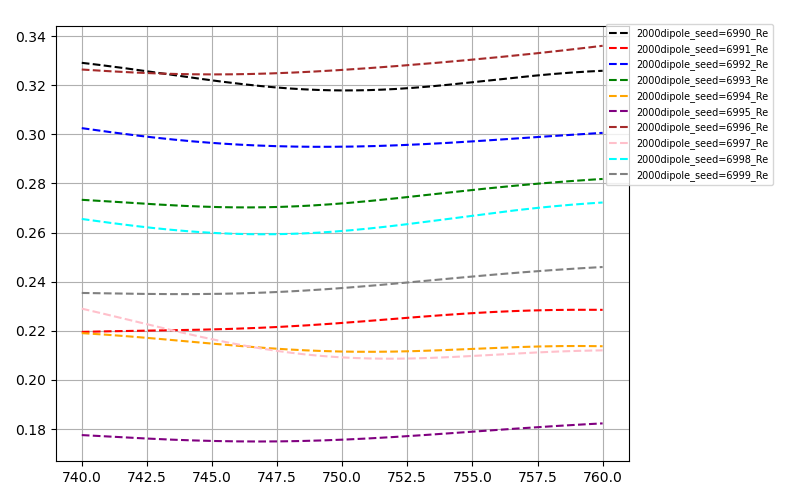

In [14]:
#各個transmission data


### 搜尋所有符合條件的 txt 檔
files = glob.glob("*.txt")  # 或指定路徑，例如 "data/*.txt"

plt.figure(figsize=(8, 5))

Linestyle = ['dashed','dashed','dashed','dashed','dashed','dashed','dashed','dashed','dashed','dashed']
Color = ['black','r','b','g','orange','purple','brown','pink','cyan','gray']

i=0
# 逐一讀取每個檔案並繪圖
for file in files:
    df = pd.read_csv(file)
    x = df["lambda(nm)"]
    y = df[" Y"]
    plt.plot(x, y, label=file.replace(".txt", ""), linewidth=1.5, linestyle=Linestyle[i], color=Color[i])  # 檔名當作圖例名稱
    i+=1

# 加上圖例與標籤
# plt.xlabel("$𝜆$ (nm)")
# plt.ylabel("$|T|$")
# plt.title("Comparison of Multiple Datasets")
plt.legend(fontsize=7, bbox_to_anchor=(1.26, 0.82), loc='center right')
# plt.ylim(0.1, 0.4)
# plt.yticks(np.arange(0.1, 0.4, 0.1))
# plt.xlim(400, 1000)
# plt.xticks(np.arange(400, 1001, 50))
# plt.xlim(740, 760)
plt.grid(True)
plt.tight_layout()
plt.show()

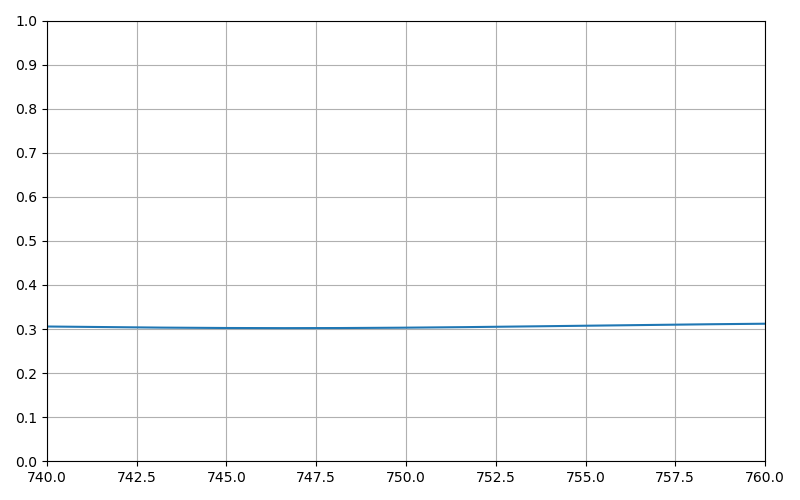

In [58]:
#平均線

# 找出所有 txt 檔 (或自行指定資料夾，例如 "data/*.txt")
files = glob.glob("*.txt")

dfs = []

for f in files:
    df = pd.read_csv(f)
    dfs.append(df)

# 合併所有 dataframe，依照 lambda(nm) 對應 Y 做平均
merged = dfs[0].copy()
for df in dfs[1:]:
    merged[" Y"] += df[" Y"]

merged[" Y"] /= len(dfs)  # 取平均

# 畫圖
plt.figure(figsize=(8, 5))
plt.plot(merged["lambda(nm)"], merged[" Y"], label='Average')


# plt.title("Average Spectrum Across Multiple Files")
plt.grid(True)
# plt.legend()
plt.ylim(0, 1)
plt.yticks(np.arange(0, 1.1, 0.1))
# plt.xlim(400, 1000)
# plt.xticks(np.arange(400, 1001, 50))
plt.xlim(740, 760)
plt.grid(True)
plt.tight_layout()
plt.show()
# plt.show()

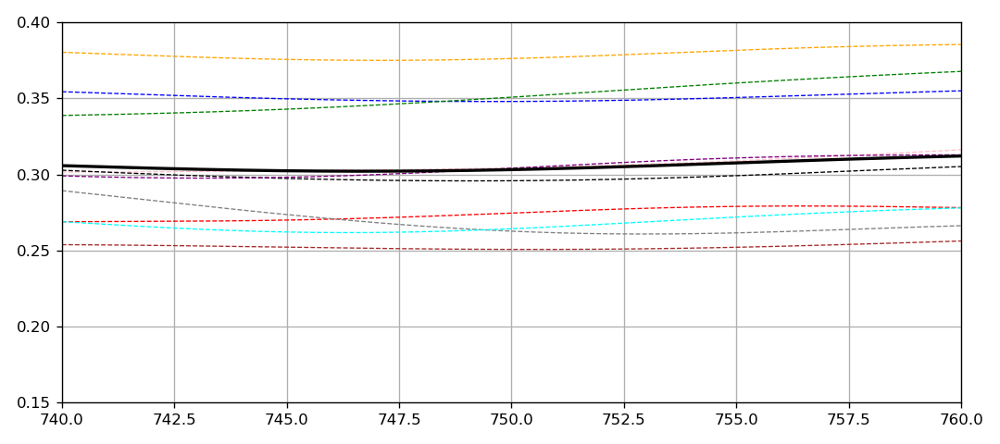

In [21]:
# 找所有 txt 檔案
files = glob.glob("*.txt")

dfs = []
for f in files:
    df = pd.read_csv(f)
    dfs.append(df)
# Linestyle = ['dashed','dashed','dashed','dashed','dashed','dotted','dotted','dotted','dotted','dotted']
Linestyle = ['dashed','dashed','dashed','dashed','dashed','dashed','dashed','dashed','dashed','dashed']
Color = ['orange','r','b','pink','black','purple','brown','gray','cyan','g']
i=0
# 先畫每條曲線
plt.figure(figsize=(9, 4), dpi=120)
for f, df in zip(files, dfs):
    plt.plot(df["lambda(nm)"], df[" Y"], alpha=1, linewidth=0.8, linestyle=Linestyle[i], color=Color[i], label=f.replace(".txt",""), zorder=2)
    i=i+1
# 計算平均
merged = dfs[0].copy()
for df in dfs[1:]:
    merged[" Y"] += df[" Y"]
merged[" Y"] /= len(dfs)

# 畫平均曲線（重點：更粗、更明顯）
plt.plot(merged["lambda(nm)"], merged[" Y"], linewidth=2, linestyle='solid', color='k', label="10 cases average", zorder=3)

# 標籤
# plt.xlabel("Wavelength (nm)")
# plt.ylabel("Y Value")
# plt.title("All Curves + Average Curve")
plt.grid(True)
# plt.legend(fontsize=10, bbox_to_anchor=(1.5, 0.5), loc='center right')
# plt.ylim(0.1, 0.4)
# plt.yticks(np.arange(0.1, 0.4, 0.1))
# plt.xlim(400, 1000)
# plt.xticks(np.arange(400, 1001, 50))
plt.ylim(0.16, 0.4)
plt.yticks(np.arange(0.15, 0.401, 0.05))
plt.xlim(740, 760)
plt.grid(True)
plt.tight_layout()
plt.show()

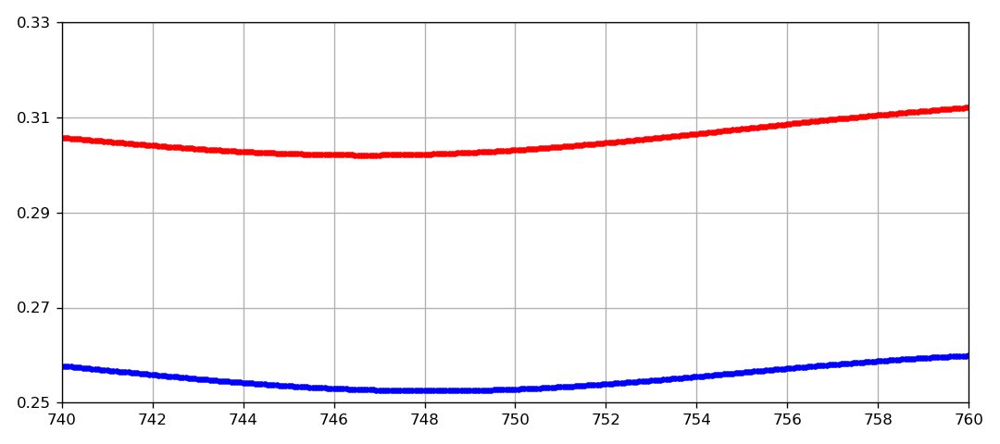

In [28]:
# 設定三個資料夾名稱
# folders = ["010dipole_average", "100dipole_average", "200dipole_average", "500dipole_average", 
#            "1000dipole_average", "2000dipole_average", "5000dipole_average"]
# Color = ['r','b','g', 'brown', 'y', 'm', 'c']
folders = ["1000dipole_average_Re(P=600nm)", "2000dipole_average_Re(P=600nm)"]
Color = ['r','b','g']
avg_curves = {}  # 用來存每組平均結果

for folder in folders:
    files = glob.glob(f"{folder}/*.txt")
    dfs = []
    
    # 讀取該資料夾所有 txt
    for f in files:
        df = pd.read_csv(f)
        dfs.append(df)
    
    # 計算平均
    merged = dfs[0].copy()
    for df in dfs[1:]:
        merged[" Y"] += df[" Y"]
    merged[" Y"] /= len(dfs)
    
    avg_curves[folder] = merged

# 畫圖
plt.figure(figsize=(9, 4), dpi=120)

# 依序畫三條平均線
i=0
for folder, data in avg_curves.items():
    plt.plot(data["lambda(nm)"], data[" Y"], linewidth=0, linestyle='solid', marker='.', color=Color[i], label=f"{folder}")
    i+=1

# plt.grid(True)
# plt.legend(fontsize=8, bbox_to_anchor=(1.6, 0.5), loc='center right')
plt.ylim(0.25, 0.33)
plt.yticks(np.arange(0.25, 0.331, 0.02))
# plt.xlim(400, 1000)
# plt.xticks(np.arange(400, 1001, 50))
plt.xlim(740, 760)
plt.xticks(np.arange(740, 761, 2))
plt.grid(True)
plt.tight_layout()
plt.show()

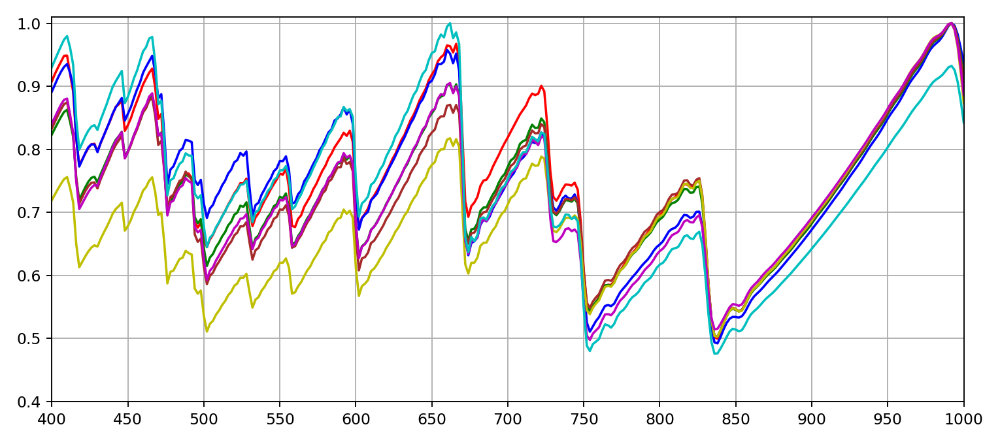

In [37]:
# 設定資料夾名稱與顏色
folders = ["010dipole_average", "100dipole_average", "200dipole_average", "500dipole_average", 
           "1000dipole_average", "2000dipole_average", "5000dipole_average"]
Color = ['r','b','g', 'brown', 'y', 'm', 'c']
avg_curves = {}

# ======= 計算各資料夾平均 =======
for folder in folders:
    files = glob.glob(f"{folder}/*.txt")
    dfs = []

    for f in files:
        df = pd.read_csv(f)
        dfs.append(df)

    merged = dfs[0].copy()
    for df in dfs[1:]:
        merged[" Y"] += df[" Y"]
    merged[" Y"] /= len(dfs)

    # 歸一化：每條平均曲線除以自己的最大值
    merged[" Y_norm"] = merged[" Y"] / merged[" Y"].max()

    avg_curves[folder] = merged

# ======= 畫圖 =======
plt.figure(figsize=(5, 5), dpi=170)

i = 0
for folder, data in avg_curves.items():
    plt.plot(data["lambda(nm)"], data[" Y_norm"], linewidth=1.5, linestyle='solid',
             color=Color[i], label=f"{folder}")
    i += 1

plt.grid(True)
# plt.legend(fontsize=10, bbox_to_anchor=(1.35, 0.5), loc='center right')
plt.ylim(0.4, 1.01)
plt.yticks(np.arange(0.4, 1.01, 0.1))
plt.xlim(400, 1000)
plt.xticks(np.arange(400, 1001, 50))
# plt.xlabel("Wavelength (nm)")
# plt.ylabel("Normalized average T")
plt.tight_layout()
plt.show()

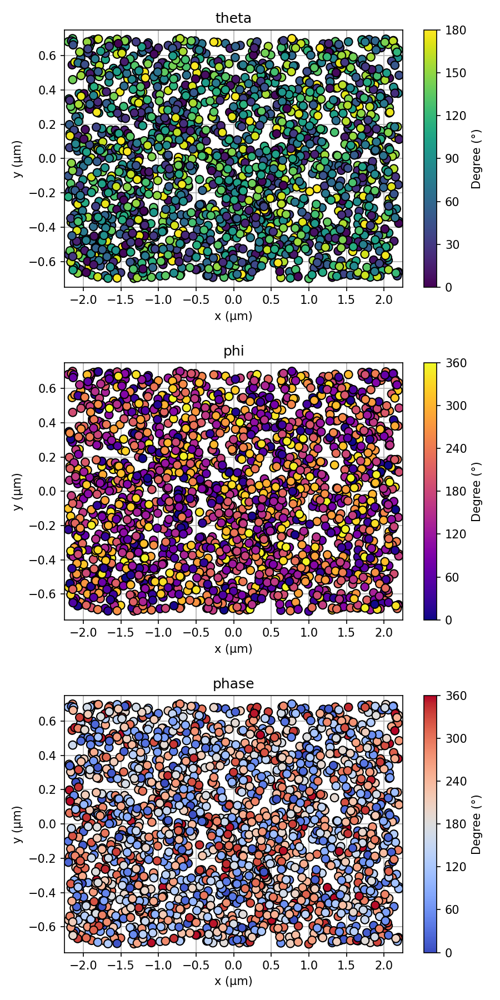

In [51]:
# ====== 讀取所有 xy 點 ======
files = glob.glob("xy_seed=6999.txt")

x_all, y_all = [], []
for f in files:
    data = np.loadtxt(f)
    x_all.extend(data[:, 0] * 1e6)   # 單位轉成 μm
    y_all.extend(data[:, 1] * 1e6)

x_all = np.array(x_all)
y_all = np.array(y_all)

# ====== 三個數值檔與設定 ======
value_files = ["theta.txt", "phi.txt", "phase.txt"]
color_maps = ["viridis", "plasma", "coolwarm"]
Title = ['theta', 'phi', 'phase']

# ====== 對應的 colorbar 範圍與 ticks ======
vmin_list = [0, 0, 0]
vmax_list = [180, 360, 360]
ticks_list = [
    np.arange(0, 181, 30),
    np.arange(0, 361, 60),
    np.arange(0, 361, 60)
]

# ====== 畫三張圖（垂直排列） ======
fig, axes = plt.subplots(3, 1, figsize=(6, 12), dpi=150)  # 3 rows × 1 col

for i, (val_file, cmap) in enumerate(zip(value_files, color_maps)):
    # 讀取數值檔
    values = np.loadtxt(val_file)

    if len(values) != len(x_all):
        raise ValueError(f"{val_file} 的數值數量 ({len(values)}) 與座標數量 ({len(x_all)}) 不一致！")

    # 畫散點圖 + colorbar 範圍控制
    sc = axes[i].scatter(
        x_all, y_all, c=values, cmap=cmap,
        s=50, edgecolor='k', zorder=2,
        vmin=vmin_list[i], vmax=vmax_list[i]
    )

    axes[i].set_xlabel("x (µm)")
    axes[i].set_ylabel("y (µm)")
    axes[i].set_xlim(-2.25, 2.25)
    axes[i].set_ylim(-0.75, 0.75)
    axes[i].grid(True)
    axes[i].set_title(Title[i])

    # 各自獨立 colorbar
    cbar = plt.colorbar(sc, ax=axes[i])
    cbar.set_label("Degree (°)")
    cbar.set_ticks(ticks_list[i])

plt.tight_layout(h_pad=2.0)  # 調整垂直間距
plt.show()

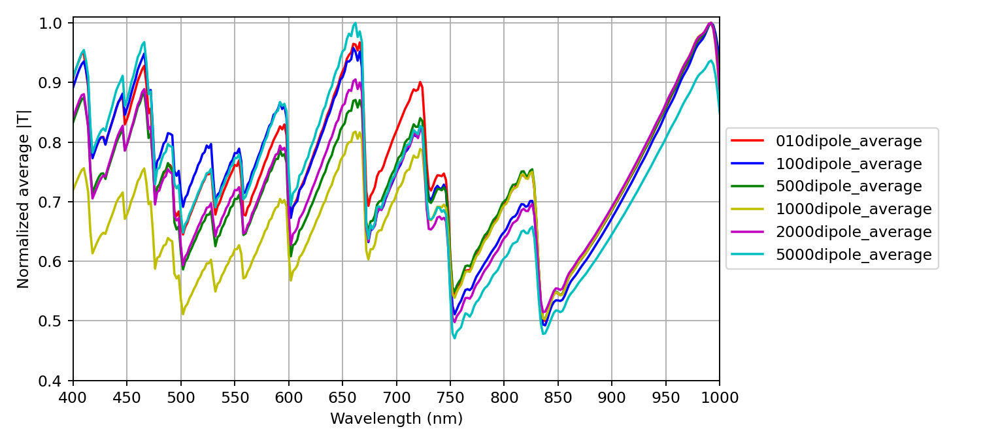

In [ ]:
# 設定資料夾名稱與顏色
folders = ["010dipole_average", "100dipole_average", "500dipole_average", 
           "1000dipole_average", "2000dipole_average", "5000dipole_average"]
Color = ['r','b','g', 'y', 'm', 'c']
avg_curves = {}

# ======= 計算各資料夾平均 =======
for folder in folders:
    files = glob.glob(f"{folder}/*.txt")
    dfs = []

    for f in files:
        df = pd.read_csv(f)
        dfs.append(df)

    merged = dfs[0].copy()
    for df in dfs[1:]:
        merged[" Y"] += df[" Y"]
    merged[" Y"] /= len(dfs)

    # 歸一化：每條平均曲線除以自己的最大值
    merged[" Y_norm"] = merged[" Y"] / merged[" Y"].max()

    avg_curves[folder] = merged

# ======= 畫圖 =======
plt.figure(figsize=(9, 4), dpi=170)

i = 0
for folder, data in avg_curves.items():
    plt.plot(data["lambda(nm)"], data[" Y_norm"], linewidth=1.5, linestyle='solid',
             color=Color[i], label=f"{folder}")
    i += 1

plt.grid(True)
plt.legend(fontsize=10, bbox_to_anchor=(1.35, 0.5), loc='center right')
plt.ylim(0.4, 1.01)
plt.yticks(np.arange(0.4, 1.01, 0.1))
plt.xlim(400, 1000)
plt.xticks(np.arange(400, 1001, 50))
plt.xlabel("Wavelength (nm)")
plt.ylabel("Normalized average |T|")
plt.tight_layout()
plt.show()

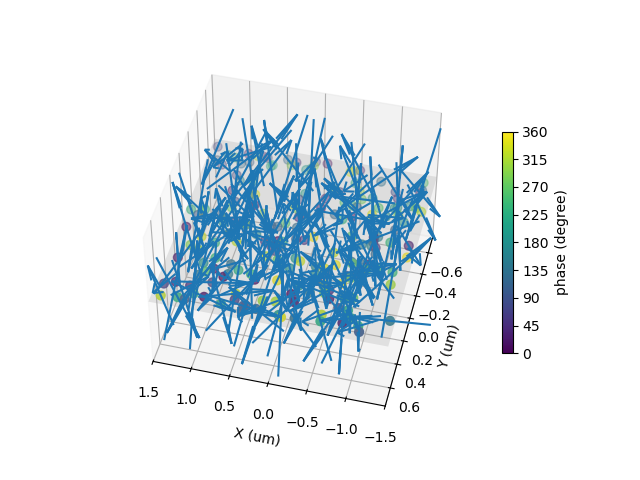

In [50]:
#各dipole的位置

# ======= 讀取位置 =======
pos = np.loadtxt("xy_seed=6991.txt")
x = pos[:,0]*np.power(10, 6)
y = pos[:,1]*np.power(10, 6)
# print(x, y)
z = np.zeros_like(x)  # 全部在同一 Z 平面

# ======= 讀取 vector phase =======
mag = np.loadtxt("phase.txt")  # 對應每一個向量的相位差

# ======= 讀取角度 =======
phi = np.deg2rad(np.loadtxt("phi.txt"))      # azimuth
theta = np.deg2rad(np.loadtxt("theta.txt"))  # elevationprint
# print(phi, theta)
# ======= 計算向量 =======
L = 0.05  # 向量長度（可調）
u = L * np.sin(theta) * np.cos(phi)
v = L * np.sin(theta) * np.sin(phi)
w = L * np.cos(theta)

x_plane = np.linspace(-1.5, 1.5, 2)
y_plane = np.linspace(-0.75, 0.75, 2)
X_plane, Y_plane = np.meshgrid(x_plane, y_plane)
Z_plane = np.zeros_like(X_plane)  # Z = 0


# ======= 畫圖 =======
fig = plt.figure(dpi=100)
ax = fig.add_subplot(111, projection='3d')
# ax.set_box_aspect([1,1,1])

# ======= 用顏色phase =======
scatter = ax.scatter(x, y, z, c=mag, cmap='viridis', vmin=0, vmax=360, s=40)
# 加 color bar
cbar = fig.colorbar(scatter, ax=ax, shrink=0.6, ticks=np.linspace(0,360, 9))
cbar.set_label("phase (degree)")

# 畫 Z=0 平面
ax.plot_surface(X_plane, Y_plane, Z_plane, color='lightgrey', alpha=0.25)
ax.view_init(elev=46, azim=104, roll=0)
ax.quiver(x, y, z, u, v, w, pivot='middle', normalize=True)
ax.set_ylim(-0.75, 0.75)
ax.set_xlim(-1.5, 1.5)
ax.set_zlim(-1.5, 1.5)
ax.set_xlabel("X (um)")
ax.set_ylabel("Y (um)")
ax.zaxis.grid(False)
ax.zaxis.line.set_lw(0)  # 隱藏 Z 軸線
ax.set_zticks([])          # 隱藏 Z 軸刻度
# ax.set_title("3D Vectors from positions + angles")

plt.show()

# simulation1 E near P --------------------------------------------------------------------------------------------------

找到以下檔案：
 - E_along_grating(470nm-x-1500nm).txt
 - E_along_grating(480nm-x-1500nm).txt
 - E_along_grating(490nm-x-1500nm).txt
 - E_along_grating(500nm-x-1500nm).txt
 - E_along_grating(510nm-x-1500nm).txt
 - E_along_grating(520nm-x-1500nm).txt
 - E_along_grating(530nm-x-1500nm).txt


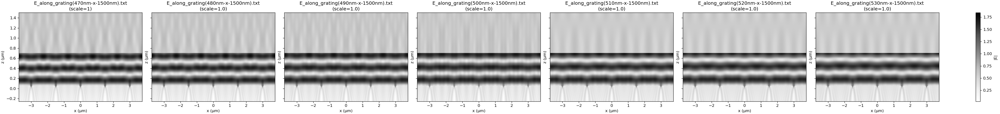

In [12]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm_near_600nm-E"  # ← 修改成你的資料夾路徑
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-900nm\x-900nm_near_450nm-E"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1050nm\x-1050nm_near_525nm-E"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm_near_400nm-E"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm_near_600nm-E"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm_near_450nm-E"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm_near_675nm-E"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1500nm\x-1500nm_near_500nm-E"

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===
# scales = [1/0.301108, 1/0.753064, 1/0.994457, 1/0.912171, 1/0.686245, 1/0.465099, 1/0.301101]  # 例：可依需要改長度
scales = [1]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='Greys', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='|E|', fraction=0.02, pad=0.04)
plt.show()

# simulation1 Ex near P ------------------------------------------------------------------------------------------------------------------------

找到以下檔案：
 - Ex_abs_along_grating(470nm-x-1500nm).txt
 - Ex_abs_along_grating(480nm-x-1500nm).txt
 - Ex_abs_along_grating(490nm-x-1500nm).txt
 - Ex_abs_along_grating(500nm-x-1500nm).txt
 - Ex_abs_along_grating(510nm-x-1500nm).txt
 - Ex_abs_along_grating(520nm-x-1500nm).txt
 - Ex_abs_along_grating(530nm-x-1500nm).txt


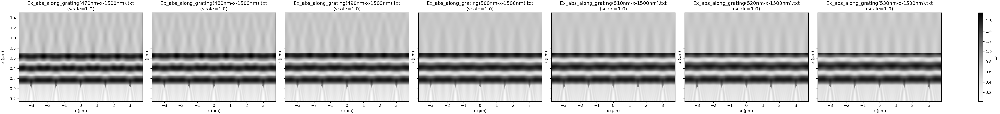

In [13]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm_near_600nm-Ex-abs"  # ← 修改成你的資料夾路徑
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-900nm\x-900nm_near_450nm-Ex-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1050nm\x-1050nm_near_525nm-Ex-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm_near_400nm-Ex-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm_near_600nm-Ex-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm_near_450nm-Ex-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm_near_675nm-Ex-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1500nm\x-1500nm_near_500nm-Ex-abs"

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===
# scales = [1/0.301108, 1/0.753064, 1/0.994457, 1/0.912171, 1/0.686245, 1/0.465099, 1/0.301101]  # 例：可依需要改長度
scales = [1.0]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='Greys', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='|Ex|', fraction=0.02, pad=0.04)
plt.show()

找到以下檔案：
 - Ex_imag_along_grating(470nm-x-1500nm).txt
 - Ex_imag_along_grating(480nm-x-1500nm).txt
 - Ex_imag_along_grating(490nm-x-1500nm).txt
 - Ex_imag_along_grating(500nm-x-1500nm).txt
 - Ex_imag_along_grating(510nm-x-1500nm).txt
 - Ex_imag_along_grating(520nm-x-1500nm).txt
 - Ex_imag_along_grating(530nm-x-1500nm).txt


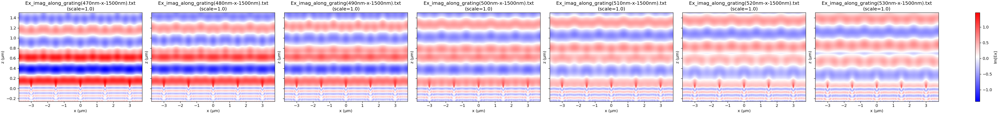

In [14]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm_near_600nm-Ex-imag"  # ← 修改成你的資料夾路徑
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-900nm\x-900nm_near_450nm-Ex-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1050nm\x-1050nm_near_525nm-Ex-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm_near_400nm-Ex-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm_near_600nm-Ex-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm_near_450nm-Ex-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm_near_675nm-Ex-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1500nm\x-1500nm_near_500nm-Ex-imag"

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===
# scales = [1/0.301108, 1/0.753064, 1/0.994457, 1/0.912171, 1/0.686245, 1/0.465099, 1/0.301101]  # 例：可依需要改長度
scales = [1.0]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='bwr', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='Im[Ex]', fraction=0.02, pad=0.04)
plt.show()

找到以下檔案：
 - Ex_real_along_grating(470nm-x-1500nm).txt
 - Ex_real_along_grating(480nm-x-1500nm).txt
 - Ex_real_along_grating(490nm-x-1500nm).txt
 - Ex_real_along_grating(500nm-x-1500nm).txt
 - Ex_real_along_grating(510nm-x-1500nm).txt
 - Ex_real_along_grating(520nm-x-1500nm).txt
 - Ex_real_along_grating(530nm-x-1500nm).txt


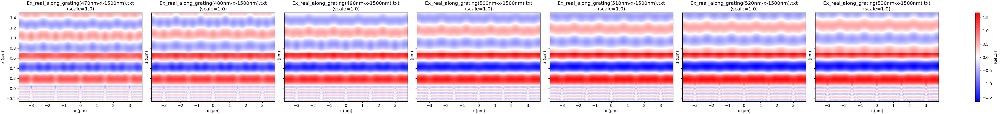

In [15]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm_near_600nm-Ex-real"  # ← 修改成你的資料夾路徑
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-900nm\x-900nm_near_450nm-Ex-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1050nm\x-1050nm_near_525nm-Ex-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm_near_400nm-Ex-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm_near_600nm-Ex-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm_near_450nm-Ex-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm_near_675nm-Ex-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1500nm\x-1500nm_near_500nm-Ex-real"

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===
# scales = [1/0.827066, 1/0.782551, 1/0.733545, 1/0.686245 ,1/0.639822, 1/0.593084, 1/0.54844]
scales = [1.0]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='bwr', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='Re[Ex]', fraction=0.02, pad=0.04)

# simulation1 Ey near P ------------------------------------------------------------------------------------------------------------------------

找到以下檔案：
 - Ey_abs_along_grating(570nm-x-0600nm).txt
 - Ey_abs_along_grating(580nm-x-0600nm).txt
 - Ey_abs_along_grating(590nm-x-0600nm).txt
 - Ey_abs_along_grating(600nm-x-0600nm).txt
 - Ey_abs_along_grating(610nm-x-0600nm).txt
 - Ey_abs_along_grating(620nm-x-0600nm).txt
 - Ey_abs_along_grating(630nm-x-0600nm).txt


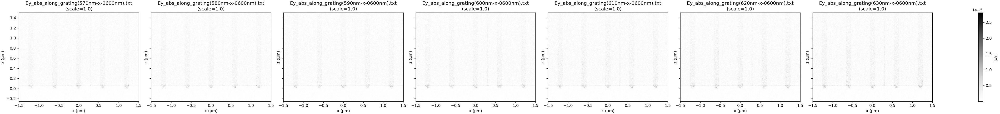

In [30]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm_near_600nm-Ey-abs"  # ← 修改成你的資料夾路徑

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===
# scales = [1/0.301108, 1/0.753064, 1/0.994457, 1/0.912171, 1/0.686245, 1/0.465099, 1/0.301101]  # 例：可依需要改長度
scales = [1.0]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='Greys', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='|Ey|', fraction=0.02, pad=0.04)
plt.show()

找到以下檔案：
 - Ey_imag_along_grating(570nm-x-0600nm).txt
 - Ey_imag_along_grating(580nm-x-0600nm).txt
 - Ey_imag_along_grating(590nm-x-0600nm).txt
 - Ey_imag_along_grating(600nm-x-0600nm).txt
 - Ey_imag_along_grating(610nm-x-0600nm).txt
 - Ey_imag_along_grating(620nm-x-0600nm).txt
 - Ey_imag_along_grating(630nm-x-0600nm).txt


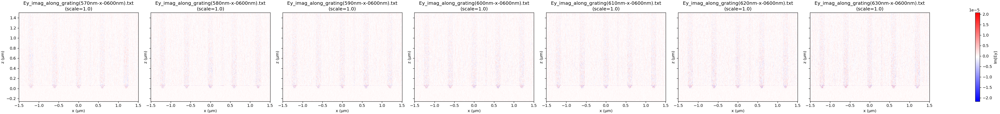

In [46]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm_near_600nm-Ey-imag"  # ← 修改成你的資料夾路徑

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===
# scales = [1/0.301108, 1/0.753064, 1/0.994457, 1/0.912171, 1/0.686245, 1/0.465099, 1/0.301101]  # 例：可依需要改長度
scales = [1.0]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='bwr', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='Im[Ey]', fraction=0.02, pad=0.04)
plt.show()

找到以下檔案：
 - Ey_real_along_grating(570nm-x-0600nm).txt
 - Ey_real_along_grating(580nm-x-0600nm).txt
 - Ey_real_along_grating(590nm-x-0600nm).txt
 - Ey_real_along_grating(600nm-x-0600nm).txt
 - Ey_real_along_grating(610nm-x-0600nm).txt
 - Ey_real_along_grating(620nm-x-0600nm).txt
 - Ey_real_along_grating(630nm-x-0600nm).txt


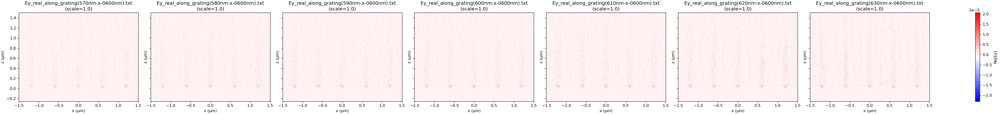

In [34]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm_near_600nm-Ey-real"  # ← 修改成你的資料夾路徑

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===
# scales = [1/0.827066, 1/0.782551, 1/0.733545, 1/0.686245 ,1/0.639822, 1/0.593084, 1/0.54844]
scales = [1.0]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='bwr', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='Re[Ey]', fraction=0.02, pad=0.04)

# simulation1 Ez near P ------------------------------------------------------------------------------------------------------------------------

找到以下檔案：
 - Ez_abs_along_grating(470nm-x-1500nm).txt
 - Ez_abs_along_grating(480nm-x-1500nm).txt
 - Ez_abs_along_grating(490nm-x-1500nm).txt
 - Ez_abs_along_grating(500nm-x-1500nm).txt
 - Ez_abs_along_grating(510nm-x-1500nm).txt
 - Ez_abs_along_grating(520nm-x-1500nm).txt
 - Ez_abs_along_grating(530nm-x-1500nm).txt


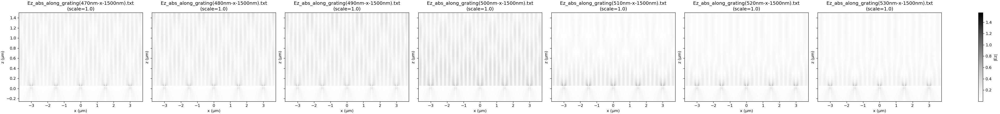

In [16]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm_near_600nm-Ez-abs"  # ← 修改成你的資料夾路徑
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-900nm\x-900nm_near_450nm-Ez-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1050nm\x-1050nm_near_525nm-Ez-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm_near_400nm-Ez-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm_near_600nm-Ez-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm_near_450nm-Ez-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm_near_675nm-Ez-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1500nm\x-1500nm_near_500nm-Ez-abs"

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===
# scales = [1/0.301108, 1/0.753064, 1/0.994457, 1/0.912171, 1/0.686245, 1/0.465099, 1/0.301101]  # 例：可依需要改長度
scales = [1.0]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='Greys', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='|Ez|', fraction=0.02, pad=0.04)
plt.show()

找到以下檔案：
 - Ez_imag_along_grating(470nm-x-1500nm).txt
 - Ez_imag_along_grating(480nm-x-1500nm).txt
 - Ez_imag_along_grating(490nm-x-1500nm).txt
 - Ez_imag_along_grating(500nm-x-1500nm).txt
 - Ez_imag_along_grating(510nm-x-1500nm).txt
 - Ez_imag_along_grating(520nm-x-1500nm).txt
 - Ez_imag_along_grating(530nm-x-1500nm).txt


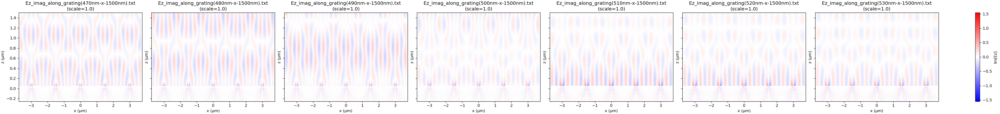

In [17]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm_near_600nm-Ez-imag"  # ← 修改成你的資料夾路徑
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-900nm\x-900nm_near_450nm-Ez-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1050nm\x-1050nm_near_525nm-Ez-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm_near_400nm-Ez-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm_near_600nm-Ez-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm_near_450nm-Ez-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm_near_675nm-Ez-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1500nm\x-1500nm_near_500nm-Ez-imag"

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===
# scales = [1/0.301108, 1/0.753064, 1/0.994457, 1/0.912171, 1/0.686245, 1/0.465099, 1/0.301101]  # 例：可依需要改長度
scales = [1.0]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='bwr', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='Im[Ez]', fraction=0.02, pad=0.04)
plt.show()

找到以下檔案：
 - Ez_real_along_grating(470nm-x-1500nm).txt
 - Ez_real_along_grating(480nm-x-1500nm).txt
 - Ez_real_along_grating(490nm-x-1500nm).txt
 - Ez_real_along_grating(500nm-x-1500nm).txt
 - Ez_real_along_grating(510nm-x-1500nm).txt
 - Ez_real_along_grating(520nm-x-1500nm).txt
 - Ez_real_along_grating(530nm-x-1500nm).txt


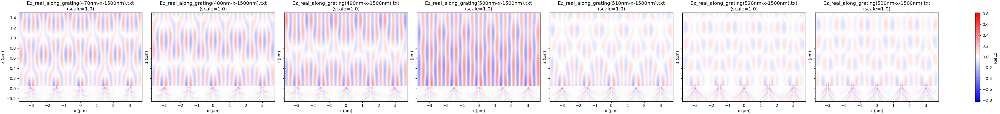

In [18]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm_near_600nm-Ez-real"  # ← 修改成你的資料夾路徑
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-900nm\x-900nm_near_450nm-Ez-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1050nm\x-1050nm_near_525nm-Ez-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm_near_400nm-Ez-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm_near_600nm-Ez-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm_near_450nm-Ez-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm_near_675nm-Ez-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1500nm\x-1500nm_near_500nm-Ez-real"

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===
# scales = [1/0.301108, 1/0.753064, 1/0.994457, 1/0.912171, 1/0.686245, 1/0.465099, 1/0.301101]  # 例：可依需要改長度
scales = [1.0]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='bwr', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='Re[Ez]', fraction=0.02, pad=0.04)
plt.show()

# simulation1 E -----------------------------------------------------------------------------------------------------

找到以下檔案：
 - E_along_grating(400nm-x-1500nm).txt
 - E_along_grating(450nm-x-1500nm).txt
 - E_along_grating(500nm-x-1500nm).txt
 - E_along_grating(550nm-x-1500nm).txt
 - E_along_grating(600nm-x-1500nm).txt
 - E_along_grating(650nm-x-1500nm).txt
 - E_along_grating(700nm-x-1500nm).txt


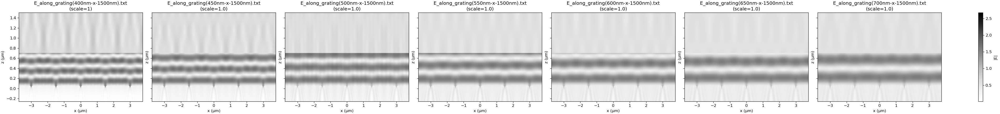

In [19]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm-E"  # ← 修改成你的資料夾路徑
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-750nm\x-750nm-E"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-900nm\x-900nm-E"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1050nm\x-1050nm-E"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm-E"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm-E"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1500nm\x-1500nm-E"

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===
# scales = [1/0.301108, 1/0.753064, 1/0.994457, 1/0.912171, 1/0.686245, 1/0.465099, 1/0.301101]  # 例：可依需要改長度
scales = [1]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='Greys', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='|E|', fraction=0.02, pad=0.04)
plt.show()

# simulation1 Ex -----------------------------------------------------------------------------------------------------

找到以下檔案：
 - Ex_abs_along_grating(400nm-x-1500nm).txt
 - Ex_abs_along_grating(450nm-x-1500nm).txt
 - Ex_abs_along_grating(500nm-x-1500nm).txt
 - Ex_abs_along_grating(550nm-x-1500nm).txt
 - Ex_abs_along_grating(600nm-x-1500nm).txt
 - Ex_abs_along_grating(650nm-x-1500nm).txt
 - Ex_abs_along_grating(700nm-x-1500nm).txt


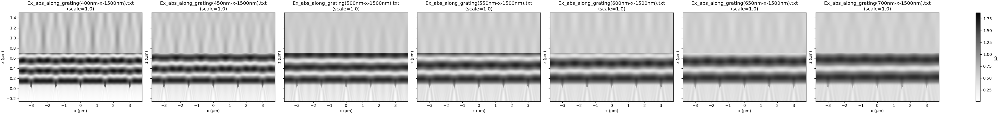

In [20]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm-Ex-abs"  # ← 修改成你的資料夾路徑
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-750nm\x-750nm-Ex-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-900nm\x-900nm-Ex-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1050nm\x-1050nm-Ex-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm-Ex-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm-Ex-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1500nm\x-1500nm-Ex-abs"

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===}}
# scales = [1/0.301108, 1/0.753064, 1/0.994457, 1/0.912171, 1/0.686245, 1/0.465099, 1/0.301101]  # 例：可依需要改長度
scales = [1.0]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='Greys', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='|Ex|', fraction=0.02, pad=0.04)
plt.show()

找到以下檔案：
 - Ex_imag_along_grating(400nm-x-1500nm).txt
 - Ex_imag_along_grating(450nm-x-1500nm).txt
 - Ex_imag_along_grating(500nm-x-1500nm).txt
 - Ex_imag_along_grating(550nm-x-1500nm).txt
 - Ex_imag_along_grating(600nm-x-1500nm).txt
 - Ex_imag_along_grating(650nm-x-1500nm).txt
 - Ex_imag_along_grating(700nm-x-1500nm).txt


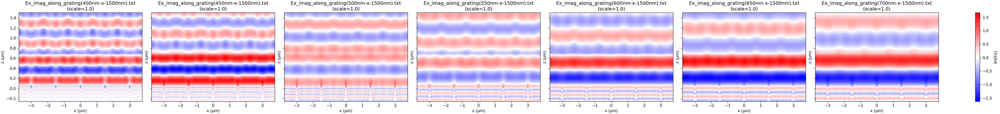

In [21]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm-Ex-imag"  # ← 修改成你的資料夾路徑
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-750nm\x-750nm-Ex-imag" 
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-900nm\x-900nm-Ex-imag" 
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1050nm\x-1050nm-Ex-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm-Ex-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm-Ex-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1500nm\x-1500nm-Ex-imag"

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===
# scales = [1/0.301108, 1/0.753064, 1/0.994457, 1/0.912171, 1/0.686245, 1/0.465099, 1/0.301101]  # 例：可依需要改長度
scales = [1.0]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='bwr', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='Im[Ex]', fraction=0.02, pad=0.04)
plt.show()

找到以下檔案：
 - Ex_real_along_grating(400nm-x-1500nm).txt
 - Ex_real_along_grating(450nm-x-1500nm).txt
 - Ex_real_along_grating(500nm-x-1500nm).txt
 - Ex_real_along_grating(550nm-x-1500nm).txt
 - Ex_real_along_grating(600nm-x-1500nm).txt
 - Ex_real_along_grating(650nm-x-1500nm).txt
 - Ex_real_along_grating(700nm-x-1500nm).txt


C:\Users\USER\AppData\Local\Temp\ipykernel_16572\658459994.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(


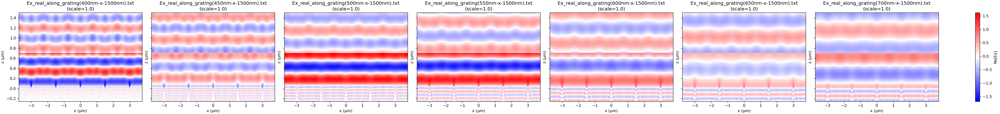

In [22]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm-Ex-real"  # ← 修改成你的資料夾路徑
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-750nm\x-750nm-Ex-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-900nm\x-900nm-Ex-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1050nm\x-1050nm-Ex-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm-Ex-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm-Ex-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1500nm\x-1500nm-Ex-real"

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===
# scales = [1/0.301108, 1/0.753064, 1/0.994457, 1/0.912171, 1/0.686245, 1/0.465099, 1/0.301101]  # 例：可依需要改長度
scales = [1.0]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='bwr', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='Re[Ex]', fraction=0.02, pad=0.04)
plt.show()

# simulation1 Ey -----------------------------------------------------------------------------------------------------

找到以下檔案：
 - Ey_abs_along_grating(400nm-x-1500nm).txt
 - Ey_abs_along_grating(450nm-x-1500nm).txt
 - Ey_abs_along_grating(500nm-x-1500nm).txt
 - Ey_abs_along_grating(550nm-x-1500nm).txt
 - Ey_abs_along_grating(600nm-x-1500nm).txt
 - Ey_abs_along_grating(650nm-x-1500nm).txt
 - Ey_abs_along_grating(700nm-x-1500nm).txt


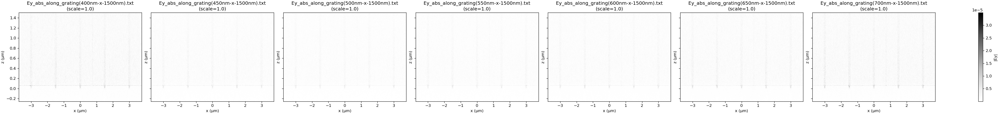

In [23]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm-Ey-abs"  # ← 修改成你的資料夾路徑
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-750nm\x-750nm-Ey-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-900nm\x-900nm-Ey-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1050nm\x-1050nm-Ey-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm-Ey-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm-Ey-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1500nm\x-1500nm-Ey-abs"

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===
# scales = [1/0.301108, 1/0.753064, 1/0.994457, 1/0.912171, 1/0.686245, 1/0.465099, 1/0.301101]  # 例：可依需要改長度
scales = [1.0]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='Greys', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='|Ey|', fraction=0.02, pad=0.04)
plt.show()

找到以下檔案：
 - Ey_imag_along_grating(400nm-x-0600nm).txt
 - Ey_imag_along_grating(450nm-x-0600nm).txt
 - Ey_imag_along_grating(500nm-x-0600nm).txt
 - Ey_imag_along_grating(550nm-x-0600nm).txt
 - Ey_imag_along_grating(600nm-x-0600nm).txt
 - Ey_imag_along_grating(650nm-x-0600nm).txt
 - Ey_imag_along_grating(700nm-x-0600nm).txt


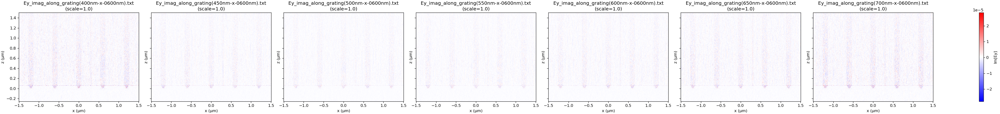

In [47]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm-Ey-imag"  # ← 修改成你的資料夾路徑

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===
# scales = [1/0.301108, 1/0.753064, 1/0.994457, 1/0.912171, 1/0.686245, 1/0.465099, 1/0.301101]  # 例：可依需要改長度
scales = [1.0]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='bwr', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='Im[Ey]', fraction=0.02, pad=0.04)
plt.show()

找到以下檔案：
 - Ey_real_along_grating(400nm-x-0600nm).txt
 - Ey_real_along_grating(450nm-x-0600nm).txt
 - Ey_real_along_grating(500nm-x-0600nm).txt
 - Ey_real_along_grating(550nm-x-0600nm).txt
 - Ey_real_along_grating(600nm-x-0600nm).txt
 - Ey_real_along_grating(650nm-x-0600nm).txt
 - Ey_real_along_grating(700nm-x-0600nm).txt


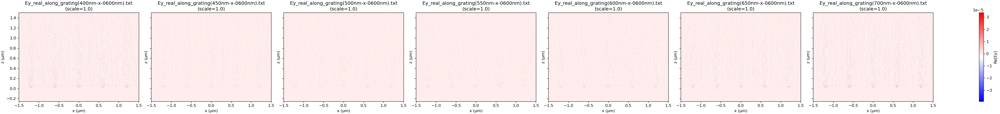

In [48]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm-Ey-real"  # ← 修改成你的資料夾路徑

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===
# scales = [1/0.301108, 1/0.753064, 1/0.994457, 1/0.912171, 1/0.686245, 1/0.465099, 1/0.301101]  # 例：可依需要改長度
scales = [1.0]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='bwr', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='Re[Ey]', fraction=0.02, pad=0.04)
plt.show()

# simulation1 Ez -----------------------------------------------------------------------------------------------------

找到以下檔案：
 - Ez_abs_along_grating(400nm-x-1500nm).txt
 - Ez_abs_along_grating(450nm-x-1500nm).txt
 - Ez_abs_along_grating(500nm-x-1500nm).txt
 - Ez_abs_along_grating(550nm-x-1500nm).txt
 - Ez_abs_along_grating(600nm-x-1500nm).txt
 - Ez_abs_along_grating(650nm-x-1500nm).txt
 - Ez_abs_along_grating(700nm-x-1500nm).txt


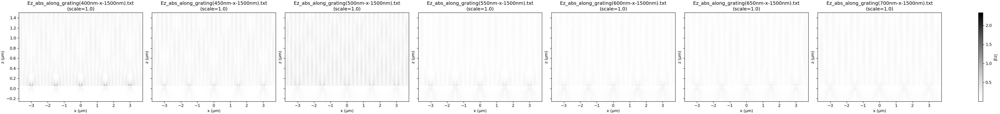

In [24]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm-Ez-abs"  # ← 修改成你的資料夾路徑
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-750nm\x-750nm-Ez-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-900nm\x-900nm-Ez-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1050nm\x-1050nm-Ez-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm-Ez-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm-Ez-abs"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1500nm\x-1500nm-Ez-abs"

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===
# scales = [1/0.301108, 1/0.753064, 1/0.994457, 1/0.912171, 1/0.686245, 1/0.465099, 1/0.301101]  # 例：可依需要改長度
scales = [1.0]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='Greys', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='|Ez|', fraction=0.02, pad=0.04)
plt.show()

找到以下檔案：
 - Ez_imag_along_grating(400nm-x-1500nm).txt
 - Ez_imag_along_grating(450nm-x-1500nm).txt
 - Ez_imag_along_grating(500nm-x-1500nm).txt
 - Ez_imag_along_grating(550nm-x-1500nm).txt
 - Ez_imag_along_grating(600nm-x-1500nm).txt
 - Ez_imag_along_grating(650nm-x-1500nm).txt
 - Ez_imag_along_grating(700nm-x-1500nm).txt


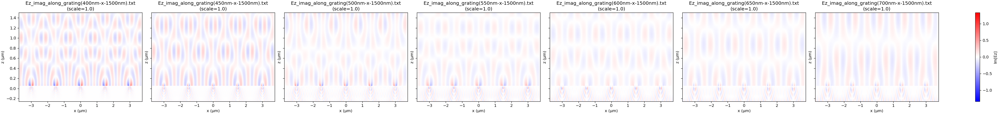

In [25]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm-Ez-imag"  # ← 修改成你的資料夾路徑
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-750nm\x-750nm-Ez-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-900nm\x-900nm-Ez-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1050nm\x-1050nm-Ez-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm-Ez-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm-Ez-imag"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1500nm\x-1500nm-Ez-imag"

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===
# scales = [1/0.301108, 1/0.753064, 1/0.994457, 1/0.912171, 1/0.686245, 1/0.465099, 1/0.301101]  # 例：可依需要改長度
scales = [1.0]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='bwr', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='Im[Ez]', fraction=0.02, pad=0.04)
plt.show()

找到以下檔案：
 - Ez_real_along_grating(400nm-x-1500nm).txt
 - Ez_real_along_grating(450nm-x-1500nm).txt
 - Ez_real_along_grating(500nm-x-1500nm).txt
 - Ez_real_along_grating(550nm-x-1500nm).txt
 - Ez_real_along_grating(600nm-x-1500nm).txt
 - Ez_real_along_grating(650nm-x-1500nm).txt
 - Ez_real_along_grating(700nm-x-1500nm).txt


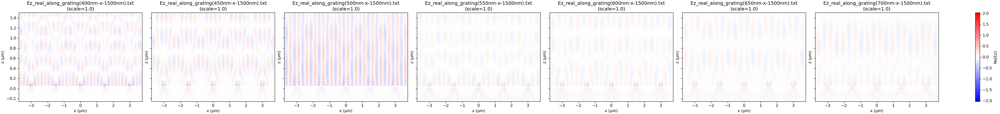

In [26]:
# === Step 1. 設定資料夾路徑 ===
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-600nm\x-600nm-Ez-real"  # ← 修改成你的資料夾路徑
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-750nm\x-750nm-Ez-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-900nm\x-900nm-Ez-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1050nm\x-1050nm-Ez-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1200nm\x-1200nm-Ez-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1350nm\x-1350nm-Ez-real"
folder = r"C:\Users\USER\Liu\code\VectorVortexBeam\COM_transfer\x-1500nm\x-1500nm-Ez-real"

# 取得該資料夾所有 .txt 檔案（自動排序）
files = sorted([f for f in os.listdir(folder) if f.endswith(".txt")])

# 可選：顯示一下找到哪些檔案
print("找到以下檔案：")
for f in files:
    print(" -", f)

# === Step 2. 設定倍率（若數量不符，會自動補 1.0） ===
# scales = [1/0.301108, 1/0.753064, 1/0.994457, 1/0.912171, 1/0.686245, 1/0.465099, 1/0.301101]  # 例：可依需要改長度
scales = [1.0]
if len(scales) < len(files):
    scales += [1.0] * (len(files) - len(scales))

# === Step 3. 定義讀取函式 ===
def read_lumerical_xz(filepath):
    """讀取 Lumerical XZ 平面 txt 檔"""
    with open(filepath, 'r') as f:
        lines = f.readlines()

    x_start = z_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('x('):
            x_start = i
        elif line.startswith('z('):
            z_start = i
        elif line.startswith('XZPlane'):
            field_start = i

    def extract_shape(s):
        match = re.findall(r'\((\d+),\s*(\d+)\)', s)
        return int(match[-1][0]), int(match[-1][1])  # 抓最後一組數字

    nx, _ = extract_shape(lines[x_start])
    nz, _ = extract_shape(lines[z_start])

    x = np.loadtxt(lines[x_start + 1 : x_start + 1 + nx])
    z = np.loadtxt(lines[z_start + 1 : z_start + 1 + nz])
    field = np.loadtxt(lines[field_start + 1 :])
    E = field.reshape((nx, nz)).T  # z 為縱軸
    return x, z, E

# === Step 4. 讀取所有檔案 ===
datasets = []
for fname, scale in zip(files, scales):
    filepath = os.path.join(folder, fname)
    x, z, E = read_lumerical_xz(filepath)
    datasets.append((fname, x, z, E * scale))

# === Step 5. 設定共用 colorbar 範圍 ===
vmin = min(np.min(E) for _, _, _, E in datasets)
vmax = max(np.max(E) for _, _, _, E in datasets)
# 或手動設定，例如：
# vmin, vmax = -0.2, 0.2

# === Step 6. 繪圖 ===
fig, axes = plt.subplots(
    1, len(datasets),
    figsize=(5 * len(datasets), 4),
    sharex=True, sharey=True,
    constrained_layout=True,  # ✅ 不會有 tight_layout 警告
    dpi=120
)

if len(datasets) == 1:
    axes = [axes]

X, Z = np.meshgrid(x, z)

for ax, (fname, x, z, E), scale in zip(axes, datasets, scales):
    im = ax.pcolormesh(X, Z, E, shading='auto', cmap='bwr', vmin=vmin, vmax=vmax)
    ax.set_title(f"{fname}\n(scale={scale})")
    ax.set_xlabel('x (µm)')
    ax.set_ylabel('z (µm)')

fig.colorbar(im, ax=axes, orientation='vertical', label='Re[Ez]', fraction=0.02, pad=0.04)
plt.show()

# help

help  

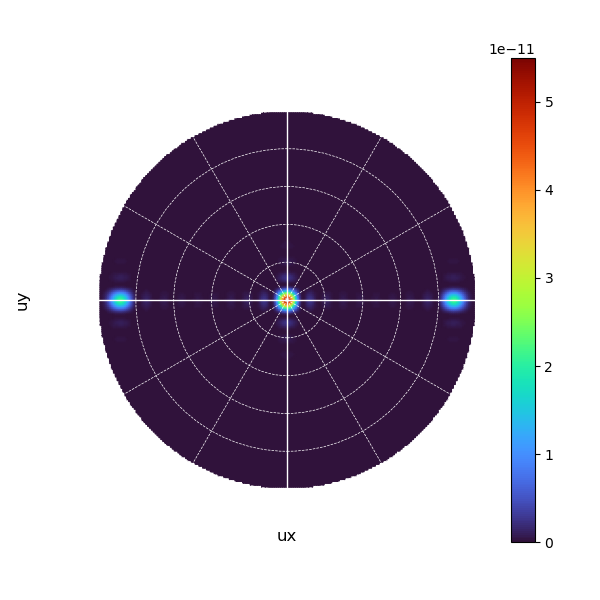

In [56]:
# === Step 1. 指定兩個檔案路徑 ===
# file2 = r"C:\Users\USER\Lumerical Files\simulation1\DATA_Re\far_field_Re\far-field-upward_filter=0_Re(x-SiO2-Si).txt"  # 場2
file2 = r"C:\Users\USER\Lumerical Files\simulation1\DATA_Re\far_field_Re\far-field-upward_filter=0_Re(x-0600nm).txt"  # 場2
file1 = r"C:\Users\USER\Lumerical Files\simulation1\PW-x-無結構\Data_vaccume_x\far_field_vaccume(x-600nm).txt"  # 場1

# === Step 2. 讀取函式 ===
def read_lumerical_xy(filepath):
    with open(filepath, 'r') as f:
        lines = f.readlines()
    
    ux_start = uy_start = field_start = None
    for i, line in enumerate(lines):
        if line.startswith('ux('):
            ux_start = i
        elif line.startswith('uy('):
            uy_start = i
        elif "XYPlane" in line and "(" in line and ")" in line:
            field_start = i

    def extract_shape(s):
        match = re.search(r'\((\d+),\s*(\d+)\)', s)
        return int(match.group(1)), int(match.group(2))

    nx, ny = extract_shape(lines[field_start])

    ux = np.loadtxt(lines[ux_start + 1 : ux_start + 1 + nx])
    uy = np.loadtxt(lines[uy_start + 1 : uy_start + 1 + ny])

    field = np.loadtxt(lines[field_start + 1 : field_start + 1 + ny])
    field = field.reshape((ny, nx))
    return ux, uy, field

# === Step 3. 讀取資料 ===
ux1, uy1, E1 = read_lumerical_xy(file1)
ux2, uy2, E2 = read_lumerical_xy(file2)

# === Step 4. 處理電場 ===
E = E2  # 或 E2 - E1
# E_log = np.log10(np.maximum(np.abs(E), 1e-25))
E_log = np.abs(E)

# === Step 5. 建立網格 (ux 為橫軸, uy 為縱軸) ===
UX, UY = np.meshgrid(ux1, uy1)

# === Step 6. 遮罩非圓形區域 ===
mask = UX**2 + UY**2 > 1
E_log_masked = np.ma.array(E_log, mask=mask)

# === Step 7. 繪圖 ===
fig, ax = plt.subplots(figsize=(6, 6))

# 主圖（平滑 shading，無格線）
im = ax.pcolormesh(UX, UY, E_log_masked.T, cmap='turbo', shading='gouraud',
                   vmin=0, vmax=5.5*np.power(0.1, 11), antialiased=True)
# vmin=-25, vmax=-9
# === Step 8. 加上極座標線（無文字） ===
radii = [0.2, 0.4, 0.6, 0.8, 1.0]
angles = np.arange(0, 360, 30)

# 畫圓形輔助線
for r in radii:
    circle = plt.Circle((0, 0), r, color='white', linestyle='--', linewidth=0.5, fill=False)
    ax.add_artist(circle)

# 畫角度線
for theta in np.deg2rad(angles):
    ax.plot([0, np.cos(theta)], [0, np.sin(theta)], color='white', linestyle='--', linewidth=0.5)

# === Step 9. 主座標軸 ===
ax.axhline(0, color='white', linewidth=1.0)
ax.axvline(0, color='white', linewidth=1.0)

# === Step 10. 座標設定 ===
ax.set_xlabel("ux", fontsize=12)
ax.set_ylabel("uy", fontsize=12)
ax.set_xlim(-1.05, 1.05)
ax.set_ylim(-1.05, 1.05)
ax.set_aspect('equal', adjustable='box')

# === Step 11. colorbar ===
cbar = fig.colorbar(im, ax=ax, shrink=0.85)
# cbar.set_label('log10(|E|²)', fontsize=11)

# === Step 12. 美化 ===
ax.tick_params(color='white', labelcolor='white', direction='out', length=4)
for spine in ax.spines.values():
    spine.set_color('white')

ax.set_facecolor('white')  # 讓背景顏色與極線對比清楚

plt.tight_layout()
plt.show()